## janesick_nature_comms_2023

In [ ]:
import math
from collections import namedtuple, Counter

import numpy as np
import scanpy as sc
import pandas as pd

## Image manipulation and geometry
from cv2 import perspectiveTransform
from ome_types import from_tiff
from skimage.measure import points_in_poly

from scipy.spatial import KDTree, ConvexHull
from scipy.sparse import csc_matrix
from shapely.geometry import LinearRing

## Plotting imports
from matplotlib import pyplot as plt
from matplotlib.patches import Polygon
from matplotlib.collections import PatchCollection
from matplotlib.colors import LinearSegmentedColormap, to_hex, Colormap
from matplotlib.axes import Axes


def hexlist_to_cmap(name: str, hex_list: list[str]) -> Colormap:
    """
    Given a list of hex colors produces a matplotlib discrete colormap.

    """
    colors = [to_hex(hex_color) for hex_color in hex_list]
    cmap = LinearSegmentedColormap.from_list(name=name, colors=colors, N=len(colors))
    return cmap


def polygons_coords_to_patch_collection(
    poly_coords: list[list[float]], **patch_collection_kwargs
) -> PatchCollection:
    """
    Generates a matplotlib PatchCollection from a set of polygons. A helper function for plot_polygons.
    """
    patches = [Polygon(hexagon) for hexagon in poly_coords]
    collection = PatchCollection(patches, **patch_collection_kwargs)
    return collection


def plot_polygons(
    poly_coords: list[list[float]],
    ax: Axes = None,
    auto_set_lim: bool = True,
    **patch_collection_kwargs
):
    """
    Plots a set of polygons. Polygons may be styled using patch_collection_kwargs passed to Collection.
    e.g.
    array, facecolor, edgecolor, linewidth....
    https://matplotlib.org/stable/api/collections_api.html#matplotlib.collections.Collection

    pitfall:
    when auto_set_lim == False, a plot will no rescale to include polygons by default.
    """
    if ax is None:
        ax = plt.gca()

    ax.add_collection(
        polygons_coords_to_patch_collection(poly_coords, **patch_collection_kwargs)
    )
    if auto_set_lim:
        ax.autoscale_view()


def hex_corner_offset(corner: int, size: float) -> np.ndarray[float, (2,)]:
    """
    Helper function for polygon_corners, calculates the offset of each hexagon vertex from the center.
    """
    angle_deg = 60 * corner - 30
    angle_rad = math.pi / 180 * angle_deg
    offset = np.array([size[0] * math.cos(angle_rad), size[1] * math.sin(angle_rad)])
    return offset


def polygon_corners(
    center: np.ndarray[float, (2,)], size: float
) -> np.ndarray[float, (6, 2)]:
    """
    Generates the polygon vertices for a hexegon of size at origin center.
    Used for plotting Visium space filling Hexagons.
    Reference for working with Hexagons: https://www.redblobgames.com/grids/hexagons/
    Visium spots are organized such that space filling hexagons are POINTY.
    """
    return np.array([center + hex_corner_offset(i, size) for i in range(0, 6)])


## The hexcodes for the colors used within the paper.
## The celltypes are mapped to the colors for plotting convenience.
celltypes, hex_codes = np.array(
    sorted(
        [
            [
                "DCIS_1",
                "#fb34cd",
            ],
            [
                "DCIS_2",
                "#FE664D",
            ],
            [
                "Myoepi_ACTA2+",
                "#009203",
            ],
            [
                "Myoepi_KRT15+",
                "#66c102",
            ],
            [
                "Invasive_Tumor",
                "#ff002a",
            ],
            [
                "Prolif_Invasive_Tumor",
                "#8e0119",
            ],
            [
                "T_Cell_&_Tumor_Hybrid",
                "#CB6035",
            ],
            [
                "Stromal",
                "#e5e022",
            ],
            [
                "Stromal_&_T_Cell_Hybrid",
                "#C1A029",
            ],
            [
                "CD4+_T_Cells",
                "#4fa9ff",
            ],
            [
                "CD8+_T_Cells",
                "#1068be",
            ],
            [
                "B_Cells",
                "#565DFD",
            ],
            [
                "Macrophages_1",
                "#10686f",
            ],
            [
                "Macrophages_2",
                "#3694a8",
            ],
            [
                "IRF7+_DCs",
                "#9f50f9",
            ],
            [
                "LAMP3+_DCs",
                "#AB76AE",
            ],
            [
                "Mast_Cells",
                "#999999",
            ],
            [
                "Perivascular-Like",
                "#515151",
            ],
            ["Endothelial", "#01257b"],
            ["Unlabeled", "#ffa5aa"],
        ],
        key=lambda x: x[0],
    )
).T
## used for converting list of celltypes to categorical.
ctype_to_code_map = {ctype: i for i, ctype in enumerate(celltypes)}
## used for converting list of celltypes to colors.
ctype_hex_map = dict(zip(celltypes, hex_codes))
## matplotlib colormap
ctype_cmap = hexlist_to_cmap("celltype_cmap", hex_codes)


def unique_encode(
    array: np.ndarray[str], return_inverse: bool = True
) -> (np.ndarray[str], np.ndarray[int]):
    """np.unique is slower then list(set(array)) thus this is an emulator function of np.unique.
    for fast encoding of categorical arrays.
    """
    unique_values = np.array(list(set(array)))
    if not return_inverse:
        return unique_values
    inverse_map = {val: i for i, val in enumerate(unique_values)}
    inverse_codes = np.array([inverse_map[i] for i in array])
    return (unique_values, inverse_codes)


def get_xenium_to_morphology_transform_from_xenium_morphology_image(
    morphology_path: str, pyramid_level: int = 0
) -> np.ndarray[np.float32]:
    """
    The Xenium coordinate system has its origin at (0,0) set to the top left of the Xenium morphology image.
    The image coordinate system is in uM and must be converted to px. This produces a transformation matrix for
    that conversion.

    https://kb.10xgenomics.com/hc/en-us/articles/11636252598925-What-are-the-Xenium-image-scale-factors-
    """
    morphology_metadata = from_tiff(morphology_path)
    origin_x = morphology_metadata.plates[0].well_origin_x
    origin_y = morphology_metadata.plates[0].well_origin_y
    physical_size_x = morphology_metadata.images[0].pixels.physical_size_x
    physical_size_y = morphology_metadata.images[0].pixels.physical_size_y
    ##Homography matrix describing scaling by pixel-size and translating by offset.
    return np.array(
        [
            [1 / physical_size_x / 2**pyramid_level, 0, 0],
            [0, 1 / physical_size_y / 2**pyramid_level, 0],
            [0, 0, 1],
        ]
    )


def get_xenium_capture_polygon_um(
    xenium_rep2_path: str,
) -> np.ndarray[int, (4, 2)]:
    """Produces a polygon which describes the Xenium morphology image shape.
    Polygons are easily transformable. Thus, this polygon is useful for sub-setting coordinates
    that lie within an image under arbitrary transformation, and of course for debug purposes.
    """
    morphology_metadata = from_tiff(xenium_rep1_path / "morphology_mip.ome.tif")
    image_shape_px = np.array(
        [
            morphology_metadata.images[0].pixels.size_x,
            morphology_metadata.images[0].pixels.size_y,
        ]
    )
    image_shape_um = (
        image_shape_px * morphology_metadata.images[0].pixels.physical_size_x
    )
    xenium_capture_polygon_um = np.array(
        [(0, 0), (0, image_shape_um[1]), image_shape_um, (image_shape_um[0], 0)]
    )
    return xenium_capture_polygon_um


def transform_coordinates(
    coords: np.ndarray[np.float32, (None, 2)], transform_matrix: np.ndarray[np.float32]
) -> np.ndarray[np.float32, (None, 2)]:
    """Transforms coordinates using transform.
    https://en.wikipedia.org/wiki/Homography_(computer_vision)
    """
    return perspectiveTransform(
        coords.reshape(-1, 1, 2).astype(np.float32), transform_matrix
    )[:, 0, :]


def get_median_spot_to_spot_distance_from_centroids(
    centroids: np.ndarray[np.float32, (None, 2)]
) -> float:
    """
    Calculates the median distance between all coordinates and their closest neighbor.
    Usefull for quickly determining the median spot <-> spot distance for Visium spots in the current coordinate system.
    Can also be directly calculated using the full resolution image pixel size and the theoretical spot <-> spot distance.
    This distance is used to generate a rough estimate of the Visium capture area and to produce space filling
    visium spot Hexagons.
    """
    tree = KDTree(centroids)
    distances, neighbor = tree.query(centroids, k=2)
    return np.median(distances[0, 1])


def generate_space_filling_visium_polygons(
    spot_coords: np.ndarray[np.float32, (None, 2)], spot_to_spot_distance: float = None
) -> list[np.ndarray[float, (6, 2)]]:
    """
    Generates hexagon polygons for every visium spot, by default the polygons are fully space filling.
    That is to say the size of the hexagon is set using the spot <-> spot distance.
    These polygons are for display purposes only and should not be used for direct analysis.
    """
    if spot_to_spot_distance is None:
        spot_to_spot_distance = get_median_spot_to_spot_distance_from_centroids(
            spot_coords
        )
    size = spot_to_spot_distance / math.sqrt(3)
    visium_hexegon_polygons = np.array(
        [polygon_corners(coord, [size, size]) for coord in spot_coords]
    )
    return visium_hexegon_polygons


def get_visium_capture_polygon(
    spot_centroids: np.ndarray[np.float32, (None, 2)], spot_diameter: float
) -> np.ndarray[np.float32, (None, 2)]:
    """
    Generates a polygon representing the visium capture area; It calculates the convex hull of all Visium spots
    then pads the convex hall by the diameter of one spot. This is used for filtering data outside the capture area
    as well as visualization.

    https://en.wikipedia.org/wiki/Convex_hull
    """
    convex_hull = ConvexHull(spot_centroids)
    convex_poly = convex_hull.points[convex_hull.vertices]

    padded_convex_polly = np.array(
        LinearRing(convex_poly).buffer(spot_diameter).exterior.coords.xy
    ).T
    return padded_convex_polly


__OUTSIDE_VISIUM_CAPTURE_AREA_BARCODE__ = "Outside_Visium_Capture_Area"


def bin_xenium_data_to_visium_spots(
    visium_spot_centroids: np.ndarray[np.float32, (None, 2)],
    visium_spot_diameter: float,
    visium_barcodes: np.ndarray[str, (None, 2)],
    xenium_coords: np.ndarray[np.float32, (None, 2)],
    xenium_to_visium_transform: np.ndarray[np.float32],
) -> np.ndarray[str]:
    """
    Assigns xenium coordinates to visium spots using a transform into the visium coordinate system.
    Coordinates are assigned by nearest neighbor.
    e.g. each Xenium transcript/cell etc is assigned to the closest Visium barcode after transformation.
    Also filters coordinates that lie outside an estimated capture area.
    """
    xenium_coords_in_visium = transform_coordinates(
        xenium_coords, xenium_to_visium_transform
    )
    kdtree = KDTree(visium_spot_centroids)
    _, neighbors = kdtree.query(xenium_coords_in_visium, k=1)
    barcode_assignments = visium_barcodes[neighbors]

    visium_capture_polygon_full_res = get_visium_capture_polygon(
        spot_centroids=visium_spot_centroids, spot_diameter=visium_spot_diameter
    )
    barcode_assignments[
        ~points_in_poly(xenium_coords_in_visium, visium_capture_polygon_full_res)
    ] = __OUTSIDE_VISIUM_CAPTURE_AREA_BARCODE__
    return barcode_assignments


def generate_anndata_matrix_from_transcript_assignments(
    barcodes: np.ndarray[str],
    feature_names: np.ndarray[str],
) -> sc.AnnData:
    """Generates a count matrix as an anndata object from a set of barcodes and feature names.
    e.g. given transcript cell assignments and gene names it will produce a barcode feature matrix.
    """
    valid_feature_names, feature_codes = unique_encode(
        feature_names, return_inverse=True
    )
    valid_barcodes, barcode_codes = unique_encode(barcodes, return_inverse=True)

    mat_dict = Counter(zip(barcode_codes, feature_codes))
    row_ind_col_ind = np.array(list(mat_dict.keys()), dtype=int).T
    data = np.array(list(mat_dict.values()), dtype=np.float32)

    obs = pd.DataFrame(index=valid_barcodes)
    var = pd.DataFrame(index=valid_feature_names)
    adata = sc.AnnData(X=csc_matrix((data, row_ind_col_ind)), obs=obs, var=var)
    return adata

### Initialize

In [2]:
import json
from collections import namedtuple, Counter

import numpy as np
import scanpy as sc
import pandas as pd

## Image manipulation and geometry
from tifffile import imread
from skimage.io import imread as skimread

## Plotting imports
from matplotlib import pyplot as plt
from matplotlib.colors import LinearSegmentedColormap, Normalize, to_hex, Colormap
from matplotlib.cm import ScalarMappable

In [15]:
from pathlib import Path
visium_path = Path("../data/janesick_nature_comms_2023/visium/").expanduser()
xenium_rep1_path = Path("../data/janesick_nature_comms_2023/xenium/rep1/outs").expanduser()
xenium_rep2_path = Path("../data/janesick_nature_comms_2023/xenium/rep2/outs").expanduser()
annot_path = Path("../data/janesick_nature_comms_2023/GSE243275_Barcode_Cell_Type_Matrices.xlsx").expanduser()

In [12]:
import time
proj_name = "janesick_nc_2023_dev"
save_dir = f"../save/dev_{proj_name}-{time.strftime('%b%d')}/"
save_dir = Path(save_dir)
save_dir.mkdir(parents=True, exist_ok=True)

data_dir = f"../data/janesick_nature_comms_2023/"
data_dir = Path(data_dir)

file_suffix = f"{time.strftime('%b%d-%H%M')}"
file_suffix

'Jun05-1233'

### Outputs for Visum data

In [ ]:
## Load Visium spot X gene matrix
visium_adata = sc.read_10x_h5(visium_path / "CytAssist_FFPE_Human_Breast_Cancer_filtered_feature_bc_matrix.h5")


/opt/anaconda3/envs/concord/lib/python3.12/site-packages/anndata/_core/anndata.py:1758: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/opt/anaconda3/envs/concord/lib/python3.12/site-packages/anndata/_core/anndata.py:1758: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [ ]:
## Load Visium spot position information
visium_tissue_positions = (
    pd.read_csv(visium_path / "spatial" / "tissue_positions.csv")
    .set_index("barcode")
    .reindex(visium_adata.obs.index)
)

## Load Visium scale metadata
## Contains scalefactors to transform between Visium full resolution and the high resolution images.
with open(visium_path / "spatial" / "scalefactors_json.json") as file:
    visium_scale_factors = json.load(file)

## Load the Visium high resolution H&E for plotting
visium_high_res_image = skimread(
    visium_path / "spatial" / "tissue_hires_image.png"
)

### IO for Xenium data

In [20]:
## Read in Xenium transcript data and decode the bytes column to string
xenium_rep1_transcripts = pd.read_parquet(xenium_rep1_path / "transcripts.parquet")
xenium_rep1_transcripts.feature_name = xenium_rep1_transcripts.feature_name.str.decode("utf-8")

## Read in the Xenium cell positions and cell metadata.
xenium_rep1_cell_info = pd.read_csv(xenium_rep1_path / "cells.csv.gz").set_index(
    "cell_id"
)

## Read in the Xenium morphology (DAPI) MIP image. Note: We are reading the image at the resolution of
## the third pyramid level: full_resolution / 2 ** 3. We are using this image for plotting.
## The Xenium imaging area is large, and the full resolution image is large enough to be slow to plot.
## Working with a lower resolution image when possible is a convenience.
pyramid_level = 3
xenium_rep1_morphology_mip_at_pyramid_level = imread(
    xenium_rep1_path / "morphology_mip.ome.tif", series=0, level=pyramid_level
)

## Read in the nucleus boundary polygon information. Xenium polygons are a plotting convenience and should not
## be used for analysis. A nucleus mask is provided for analysis of Xenium segmentation.
xenium_rep1_nucleous_boundaries_df = pd.read_parquet(
    xenium_rep1_path / "nucleus_boundaries.parquet"
)

## Transformation matrix to transform from the Xenium coordinate system to the morphology image coordinate system
## at pyramid level. Determined using the pixel size of the morphology image. 
xenium_rep1_to_morphology_at_pyramid_transformation = (
    get_xenium_to_morphology_transform_from_xenium_morphology_image(
        xenium_rep1_path / "morphology_mip.ome.tif", pyramid_level
    )
)

## Cell type assignments as determined by label transfer from a matched FLEX dataset.
## This is a supplemental file provided within the publication.
## barcode X celltype
xenium_rep1_celltype_df = pd.read_excel(
    annot_path,
    sheet_name="Xenium R1 Fig1-5 (supervised)",
    index_col=0,
)


In [18]:
## Read in Xenium transcript data and decode the bytes column to string
xenium_rep2_transcripts = pd.read_parquet(xenium_rep2_path / "transcripts.parquet")
xenium_rep2_transcripts.feature_name = xenium_rep2_transcripts.feature_name.str.decode("utf-8")

## Read in the Xenium cell positions and cell metadata.
xenium_rep2_cell_info = pd.read_csv(xenium_rep2_path / "cells.csv.gz").set_index(
    "cell_id"
)

## Read in the Xenium morphology (DAPI) MIP image. Note: We are reading the image at the resolution of
## the third pyramid level: full_resolution / 2 ** 3. We are using this image for plotting.
## The Xenium imaging area is large, and the full resolution image is large enough to be slow to plot.
## Working with a lower resolution image when possible is a convenience.
pyramid_level = 3
xenium_rep2_morphology_mip_at_pyramid_level = imread(
    xenium_rep2_path / "morphology_mip.ome.tif", series=0, level=pyramid_level
)

## Read in the nucleus boundary polygon information. Xenium polygons are a plotting convenience and should not
## be used for analysis. A nucleus mask is provided for analysis of Xenium segmentation.
xenium_rep2_nucleous_boundaries_df = pd.read_parquet(
    xenium_rep2_path / "nucleus_boundaries.parquet"
)

## Transformation matrix to transform from the Xenium coordinate system to the morphology image coordinate system
## at pyramid level. Determined using the pixel size of the morphology image. 
xenium_rep2_to_morphology_at_pyramid_transformation = (
    get_xenium_to_morphology_transform_from_xenium_morphology_image(
        xenium_rep2_path / "morphology_mip.ome.tif", pyramid_level
    )
)

## Cell type assignments as determined by label transfer from a matched FLEX dataset.
## This is a supplemental file provided within the publication.
## barcode X celltype
xenium_rep2_celltype_df = pd.read_excel(
    annot_path,
    sheet_name="Xenium R2 Fig1-5 (supervised)",
    index_col=0,
)


In [23]:
xenium_rep1_celltype_df['Cluster'].value_counts()

Cluster
Stromal                    41422
Invasive_Tumor             34374
DCIS_1                     12923
DCIS_2                     11683
Macrophages_1              11174
Endothelial                 8931
Unlabeled                   8554
CD4+_T_Cells                8453
Myoepi_ACTA2+               7078
CD8+_T_Cells                6940
B_Cells                     4987
Prolif_Invasive_Tumor       3775
Myoepi_KRT15+               2860
Macrophages_2               1624
Perivascular-Like            847
Stromal_&_T_Cell_Hybrid      607
T_Cell_&_Tumor_Hybrid        589
IRF7+_DCs                    494
LAMP3+_DCs                   298
Mast_Cells                   167
Name: count, dtype: int64

In [24]:
xenium_rep2_celltype_df['Cluster'].value_counts()

Cluster
Stromal                    38644
Invasive_Tumor             15759
DCIS_2                     10024
Macrophages_1               8052
DCIS_1                      7171
Endothelial                 6699
Myoepi_ACTA2+               6062
CD4+_T_Cells                5940
CD8+_T_Cells                4948
B_Cells                     3792
Unlabeled                   3477
Myoepi_KRT15+               2647
Prolif_Invasive_Tumor       1851
Macrophages_2               1578
Perivascular-Like            549
Stromal_&_T_Cell_Hybrid      544
IRF7+_DCs                    400
T_Cell_&_Tumor_Hybrid        248
LAMP3+_DCs                   206
Mast_Cells                   161
Name: count, dtype: int64

### The transformation matrix as determined by registration using Xenium Explorer

In [33]:
T = np.array([
    [0.13852987456368426, 2.587803046688717, -12263.56858],
    [-2.587803047, 0.13852987456368426, 40237.47308942996],
    [0, 0, 1]
])

xenium_rep1_morphology_to_visium_full_res_transformation = np.array(
    [
        [1.87594468e-02, -4.07641677e-01, 1.63476055e04],
        [3.91300071e-01, 1.26819551e-02, 4.12499099e03],
        [-8.39854141e-08, -9.91112632e-07, 1.03706895e00],
    ]
)
np.dot(T, xenium_rep1_morphology_to_visium_full_res_transformation)


array([[ 1.01623622e+00, -1.14975706e-02,  2.21129800e+02],
       [ 2.28163532e-03,  1.01677334e+00, -3.91487212e+00],
       [-8.39854141e-08, -9.91112632e-07,  1.03706895e+00]])

array([[ 1.01623622e+00, -1.14975706e-02,  2.21129800e+02],
       [ 2.28163532e-03,  1.01677334e+00, -3.91487212e+00],
       [-8.39854141e-08, -9.91112632e-07,  1.03706895e+00]])

In [ ]:
xenium_rep1_morphology_to_visium_full_res_transformation = np.array(
    [
        [1.87594468e-02, -4.07641677e-01, 1.63476055e04],
        [3.91300071e-01, 1.26819551e-02, 4.12499099e03],
        [-8.39854141e-08, -9.91112632e-07, 1.03706895e00],
    ]
)

## Transformation matrix between Xenium full resolution (DAPI) morphology image and the Xenium coordinate system.
xenium_rep1_to_morphology_transformation = (
    get_xenium_to_morphology_transform_from_xenium_morphology_image(
        xenium_rep1_path / "morphology_mip.ome.tif", 0
    )
)

## Xenium coordinates must be transformed into image coordinates before being transformed into Visium image coordinates.
## The following describes that combined transformation (a matrix multiplication of the two transformation matrices).
xenium_rep1_to_visium_full_res_transformation = (
    xenium_rep1_morphology_to_visium_full_res_transformation
    @ xenium_rep1_to_morphology_transformation
)

In [34]:
xenium_rep2_morphology_to_visium_full_res_transformation = np.array(
    [
        [0.053185509035220485,	2.594426183164292,	-10079.18006],
        [-2.594426183,	0.053185509035220485,	32259.58523189003],
        [0,	0,	1],
    ]
)

xenium_rep2_morphology_to_visium_full_res_transformation = np.linalg.inv(xenium_rep2_morphology_to_visium_full_res_transformation)

## Transformation matrix between Xenium full resolution (DAPI) morphology image and the Xenium coordinate system.
xenium_rep2_to_morphology_transformation = (
    get_xenium_to_morphology_transform_from_xenium_morphology_image(
        xenium_rep2_path / "morphology_mip.ome.tif", 0
    )
)

## Xenium coordinates must be transformed into image coordinates before being transformed into Visium image coordinates.
## The following describes that combined transformation (a matrix multiplication of the two transformation matrices).
xenium_rep2_to_visium_full_res_transformation = (
    xenium_rep2_morphology_to_visium_full_res_transformation
    @ xenium_rep2_to_morphology_transformation
)

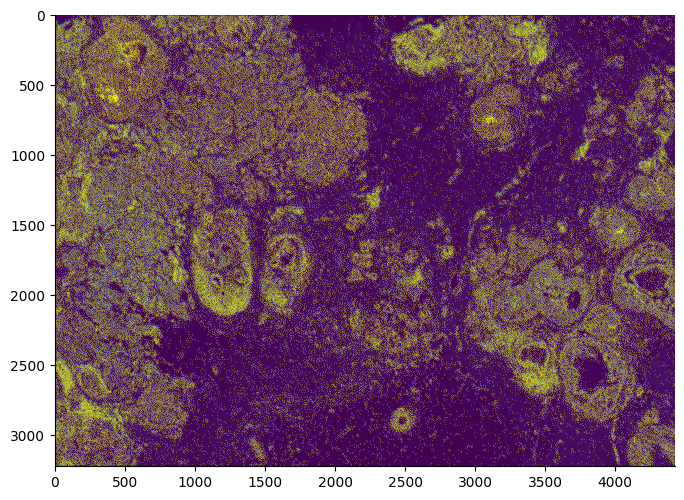

In [35]:
## data setup
## get Xenium coordinates -> transformed into Xenium morphology pixel coordinates
coords = transform_coordinates(
    xenium_rep1_cell_info[["x_centroid", "y_centroid"]].values,
    xenium_rep1_to_morphology_at_pyramid_transformation,
)

## plot style setup
fig = plt.figure(figsize=(8, 8))
ax = plt.gca()

## plotting code
ax.imshow(xenium_rep1_morphology_mip_at_pyramid_level)
ax.scatter(*coords.T, s=0.1, linewidth=0, edgecolor=None, marker="o", color="yellow")

## plot style adjustments
ax.spines.right.set_visible(False)
ax.spines.top.set_visible(False)
ax.yaxis.set_ticks_position("left")
ax.xaxis.set_ticks_position("bottom")
ax.set_aspect("equal", adjustable="box")

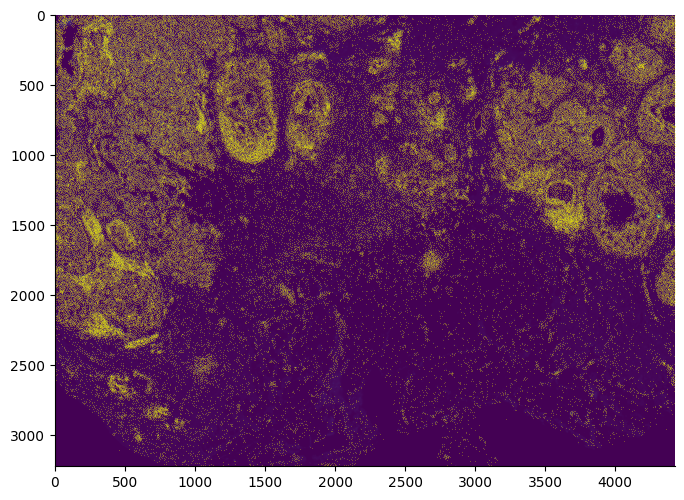

In [36]:
## data setup
## get Xenium coordinates -> transformed into Xenium morphology pixel coordinates
coords = transform_coordinates(
    xenium_rep2_cell_info[["x_centroid", "y_centroid"]].values,
    xenium_rep2_to_morphology_at_pyramid_transformation,
)

## plot style setup
fig = plt.figure(figsize=(8, 8))
ax = plt.gca()

## plotting code
ax.imshow(xenium_rep2_morphology_mip_at_pyramid_level)
ax.scatter(*coords.T, s=0.1, linewidth=0, edgecolor=None, marker="o", color="yellow")

## plot style adjustments
ax.spines.right.set_visible(False)
ax.spines.top.set_visible(False)
ax.yaxis.set_ticks_position("left")
ax.xaxis.set_ticks_position("bottom")
ax.set_aspect("equal", adjustable="box")

### Figure demonstrating the Xenium/Visium registration

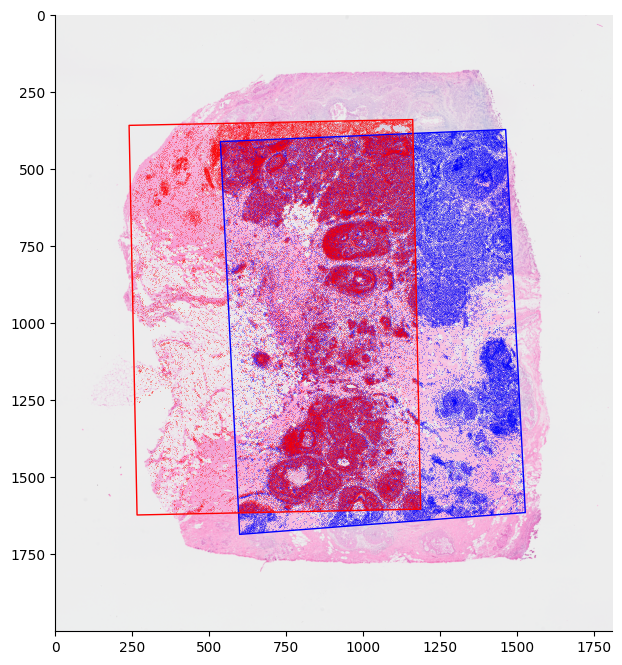

In [40]:
## data setup
## Xenium rep1 and rep2 cell coordinates are transformed first into Visium full resolution image coordinates,
## and then scaled to high resolution image coordinates.
xenium_rep1_cell_centroids_visium_high_res = (
    transform_coordinates(
        xenium_rep1_cell_info[["x_centroid", "y_centroid"]].values,
        xenium_rep1_to_visium_full_res_transformation,
    )
    * visium_scale_factors["tissue_hires_scalef"]
)
xenium_rep2_cell_centroids_visium_high_res = (
    transform_coordinates(
        xenium_rep2_cell_info[["x_centroid", "y_centroid"]].values,
        xenium_rep2_to_visium_full_res_transformation,
    )
    * visium_scale_factors["tissue_hires_scalef"]
)


## The Xenium rep1 and rep2 capture polygon is obtained and similarly transformed.
xenium_rep1_capture_polygon_um = get_xenium_capture_polygon_um(xenium_rep1_path)
xenium_rep1_capture_polygon_visium_high_res = (
    transform_coordinates(
        xenium_rep1_capture_polygon_um, xenium_rep1_to_visium_full_res_transformation
    )
    * visium_scale_factors["tissue_hires_scalef"]
)

xenium_rep2_capture_polygon_um = get_xenium_capture_polygon_um(xenium_rep2_path)
xenium_rep2_capture_polygon_visium_high_res = (
    transform_coordinates(
        xenium_rep2_capture_polygon_um, xenium_rep2_to_visium_full_res_transformation
    )
    * visium_scale_factors["tissue_hires_scalef"]
)

## plot style setup
fig = plt.figure(figsize=(8, 8))
ax = plt.gca()

## plotting code
ax.imshow(visium_high_res_image)
ax.scatter(
    *xenium_rep1_cell_centroids_visium_high_res.T,
    s=0.1,
    linewidth=0,
    edgecolor=None,
    marker="o",
    color="blue"
)
ax.scatter(
    *xenium_rep2_cell_centroids_visium_high_res.T,
    s=0.1,
    linewidth=0,
    edgecolor=None,
    marker="o",
    color="red"
)

plot_polygons(
    [xenium_rep1_capture_polygon_visium_high_res],
    ax=ax,
    facecolor=(0, 0, 0, 0),
    edgecolor="blue",
    linewidth=1,
)

plot_polygons(
    [xenium_rep2_capture_polygon_visium_high_res],
    ax=ax,
    facecolor=(0, 0, 0, 0),
    edgecolor="red",
    linewidth=1,
)

## plot style adjustments
ax.spines.right.set_visible(False)
ax.spines.top.set_visible(False)
ax.yaxis.set_ticks_position("left")
ax.xaxis.set_ticks_position("bottom")
ax.set_aspect("equal", adjustable="box")

### Figure demonstrating the Visium capture area and spot locations


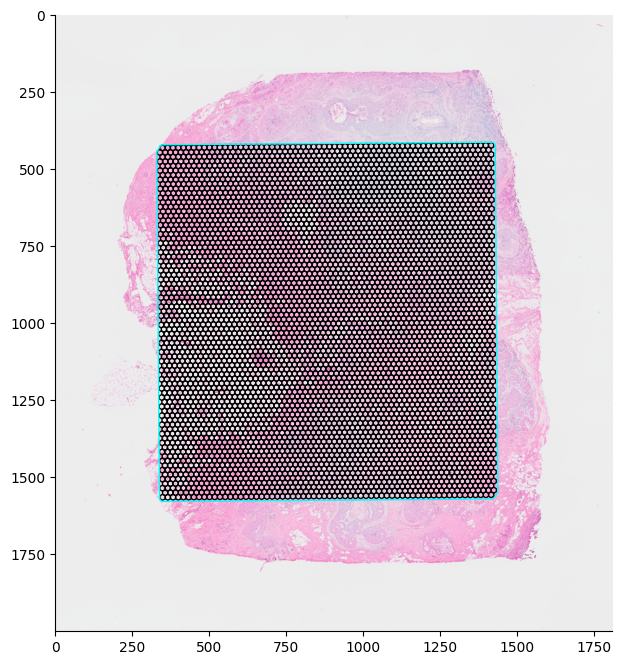

In [42]:
## data setup
## Space filling polygons are generated and then transformed in the high resolution coordinate system.
visium_hexegon_polygons = generate_space_filling_visium_polygons(
    spot_coords=visium_tissue_positions[
        ["pxl_col_in_fullres", "pxl_row_in_fullres"]
    ].values,
)

visium_capture_polygon_full_res = get_visium_capture_polygon(
    spot_centroids=visium_tissue_positions[
        ["pxl_col_in_fullres", "pxl_row_in_fullres"]
    ].values,
    spot_diameter=visium_scale_factors["spot_diameter_fullres"],
)


visium_hexagon_polygons_high_res = (
    visium_hexegon_polygons * visium_scale_factors["tissue_hires_scalef"]
)
visium_capture_polygon_high_res = (
    visium_capture_polygon_full_res * visium_scale_factors["tissue_hires_scalef"]
)


## plot style setup
fig = plt.figure(figsize=(8, 8))
ax = plt.gca()

## plotting code
ax.imshow(visium_high_res_image)
plot_polygons(
    visium_hexagon_polygons_high_res,
    ax=ax,
    facecolor=(0, 0, 0, 0),
    edgecolor="black",
    linewidth=1,
)
plot_polygons(
    [visium_capture_polygon_high_res],
    ax=ax,
    facecolor=(0, 0, 0, 0),
    edgecolor="cyan",
    linewidth=1,
)

## plot style adjustments
ax.spines.right.set_visible(False)
ax.spines.top.set_visible(False)
ax.yaxis.set_ticks_position("left")
ax.xaxis.set_ticks_position("bottom")
ax.set_aspect("equal", adjustable="box")

### Figure demonstrating the different capture areas for the Xenium assay and the Visium assay run on two different slides.

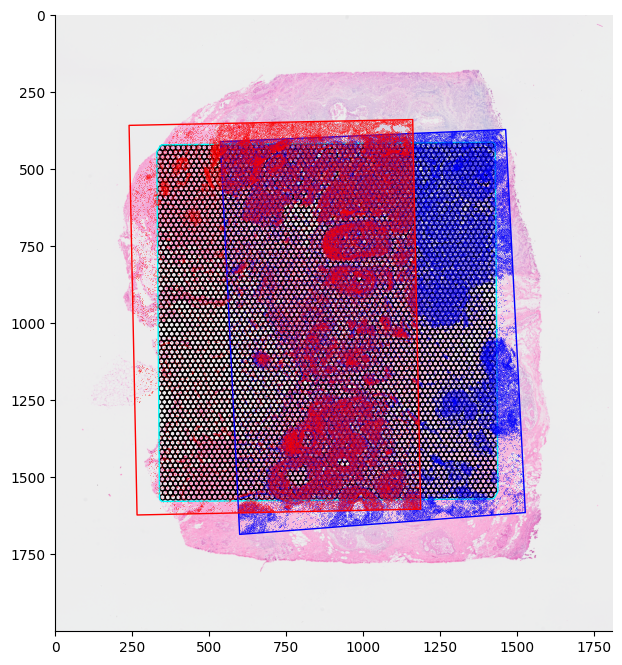

In [43]:
## Data setup
## Xenium rep1 and rep2 cell cordinates are transformed into Visium high resolution image coordinates.
xenium_rep1_cell_centroids_visium_high_res = (
    transform_coordinates(
        xenium_rep1_cell_info[["x_centroid", "y_centroid"]].values,
        xenium_rep1_to_visium_full_res_transformation,
    )
    * visium_scale_factors["tissue_hires_scalef"]
)
xenium_rep2_cell_centroids_visium_high_res = (
    transform_coordinates(
        xenium_rep2_cell_info[["x_centroid", "y_centroid"]].values,
        xenium_rep2_to_visium_full_res_transformation,
    )
    * visium_scale_factors["tissue_hires_scalef"]
)

## Xenium rep1 and rep2 capture area polygon is transformed into Visium high resolution image coordinates.
xenium_rep1_capture_polygon_um = get_xenium_capture_polygon_um(xenium_rep1_path)
xenium_rep1_capture_polygon_visium_high_res = (
    transform_coordinates(
        xenium_rep1_capture_polygon_um, xenium_rep1_to_visium_full_res_transformation
    )
    * visium_scale_factors["tissue_hires_scalef"]
)

xenium_rep2_capture_polygon_um = get_xenium_capture_polygon_um(xenium_rep2_path)
xenium_rep2_capture_polygon_visium_high_res = (
    transform_coordinates(
        xenium_rep2_capture_polygon_um, xenium_rep2_to_visium_full_res_transformation
    )
    * visium_scale_factors["tissue_hires_scalef"]
)

## Space filling polygons are generated and then transformed  into high resolution image coordinates.
visium_hexegon_polygons = generate_space_filling_visium_polygons(
    spot_coords=visium_tissue_positions[
        ["pxl_col_in_fullres", "pxl_row_in_fullres"]
    ].values,
)
## Visium capture area polygons are generated and then transformed into high resolution image coordinates.
visium_catpure_polygon_full_res = get_visium_capture_polygon(
    spot_centroids=visium_tissue_positions[
        ["pxl_col_in_fullres", "pxl_row_in_fullres"]
    ].values,
    spot_diameter=visium_scale_factors["spot_diameter_fullres"],
)

visium_hexagon_polygons_high_res = (
    visium_hexegon_polygons * visium_scale_factors["tissue_hires_scalef"]
)
visium_catpure_polygon_high_res = (
    visium_catpure_polygon_full_res * visium_scale_factors["tissue_hires_scalef"]
)

## plot style setup
fig = plt.figure(figsize=(8, 8))
ax = plt.gca()

## plotting code
ax.imshow(visium_high_res_image)
plot_polygons(
    visium_hexagon_polygons_high_res,
    ax=ax,
    facecolor=(0, 0, 0, 0),
    edgecolor="black",
    linewidth=1,
)
plot_polygons(
    [visium_catpure_polygon_high_res],
    ax=ax,
    facecolor=(0, 0, 0, 0),
    edgecolor="cyan",
    linewidth=1,
)

ax.scatter(
    *xenium_rep1_cell_centroids_visium_high_res.T,
    s=0.1,
    linewidth=0,
    edgecolor=None,
    marker="o",
    color="blue"
)
plot_polygons(
    [xenium_rep1_capture_polygon_visium_high_res],
    ax=ax,
    facecolor=(0, 0, 0, 0),
    edgecolor="blue",
    linewidth=1,
)

ax.scatter(
    *xenium_rep2_cell_centroids_visium_high_res.T,
    s=0.1,
    linewidth=0,
    edgecolor=None,
    marker="o",
    color="red"
)
plot_polygons(
    [xenium_rep2_capture_polygon_visium_high_res],
    ax=ax,
    facecolor=(0, 0, 0, 0),
    edgecolor="red",
    linewidth=1,
)

## plot style adjustments
ax.spines.right.set_visible(False)
ax.spines.top.set_visible(False)
ax.yaxis.set_ticks_position("left")
ax.xaxis.set_ticks_position("bottom")
ax.set_aspect("equal", adjustable="box")

### Figure showing Xenium data overlaid with label-transferred cell types

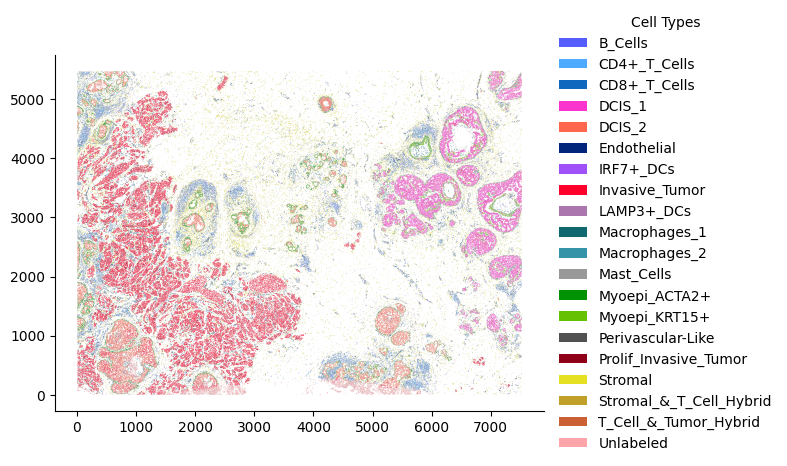

In [44]:
## Data setup
## Collection Xenium nucleous boundaries from the parquet file. Polygons are organized in order and each row
## corresponds to an individual vertex.
## This line is the slow bit. Cache for faster plotting.
xenium_nucleous_polygons = [
    poly[["vertex_x", "vertex_y"]].values
    for i, poly in xenium_rep1_nucleous_boundaries_df.groupby("cell_id")
]

## Plot style setup
fig = plt.figure(figsize=(8, 8))
ax = plt.gca()

## Plotting code
plot_polygons(
    xenium_nucleous_polygons,
    ax=ax,
    array=list(map(ctype_to_code_map.get, xenium_rep1_celltype_df.Cluster.values)),
    edgecolor="black",
    linewidth=0.01,
    norm=Normalize(vmin=0, vmax=len(celltypes)),
    cmap=ctype_cmap,
)

## Plot style adjustments
ax.spines.right.set_visible(False)
ax.spines.top.set_visible(False)
ax.yaxis.set_ticks_position("left")
ax.xaxis.set_ticks_position("bottom")
ax.set_aspect("equal", adjustable="box")

from matplotlib.patches import Patch

# Generate legend handles
legend_elements = [
    Patch(
        facecolor=ctype_cmap(Normalize(vmin=0, vmax=len(celltypes))(i)),
        label=celltype
    )
    for i, celltype in enumerate(celltypes)
]

# Add the legend
ax.legend(
    handles=legend_elements,
    title="Cell Types",
    loc="center left",
    bbox_to_anchor=(1.02, 0.5),  # place to the right
    borderaxespad=0,
    frameon=False,
)

# Save figure
plt.tight_layout()
plt.savefig(
    "xenium_rep1_celltype_polygons.png",
    dpi=300,
    bbox_inches="tight",
    pad_inches=0.1,
)

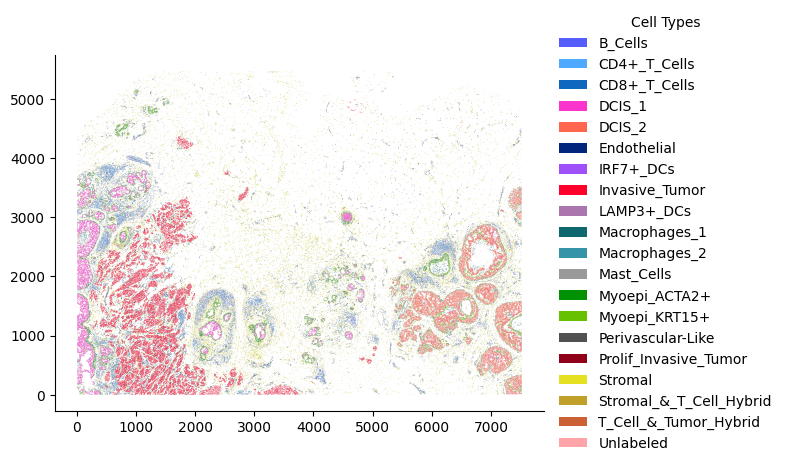

In [45]:
## Data setup
## Collection Xenium nucleous boundaries from the parquet file. Polygons are organized in order and each row
## corresponds to an individual vertex.
## This line is the slow bit. Cache for faster plotting.
xenium_nucleous_polygons = [
    poly[["vertex_x", "vertex_y"]].values
    for i, poly in xenium_rep2_nucleous_boundaries_df.groupby("cell_id")
]

## Plot style setup
fig = plt.figure(figsize=(8, 8))
ax = plt.gca()

## Plotting code
plot_polygons(
    xenium_nucleous_polygons,
    ax=ax,
    array=list(map(ctype_to_code_map.get, xenium_rep2_celltype_df.Cluster.values)),
    edgecolor="black",
    linewidth=0.01,
    norm=Normalize(vmin=0, vmax=len(celltypes)),
    cmap=ctype_cmap,
)

## Plot style adjustments
ax.spines.right.set_visible(False)
ax.spines.top.set_visible(False)
ax.yaxis.set_ticks_position("left")
ax.xaxis.set_ticks_position("bottom")
ax.set_aspect("equal", adjustable="box")

from matplotlib.patches import Patch

# Generate legend handles
legend_elements = [
    Patch(
        facecolor=ctype_cmap(Normalize(vmin=0, vmax=len(celltypes))(i)),
        label=celltype
    )
    for i, celltype in enumerate(celltypes)
]

# Add the legend
ax.legend(
    handles=legend_elements,
    title="Cell Types",
    loc="center left",
    bbox_to_anchor=(1.02, 0.5),  # place to the right
    borderaxespad=0,
    frameon=False,
)

# Save figure
plt.tight_layout()
plt.savefig(
    "xenium_rep2_celltype_polygons.png",
    dpi=300,
    bbox_inches="tight",
    pad_inches=0.1,
)

### Figure demonstrating cell and cell type interpolation of Visium data from Xenium data

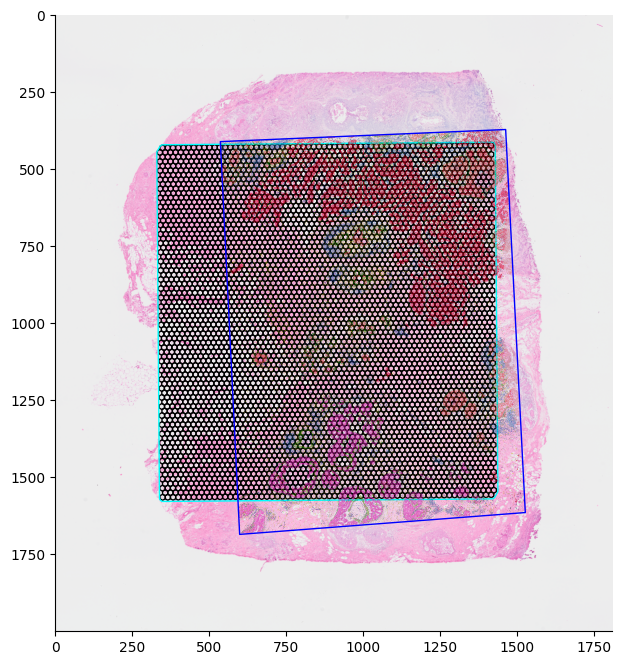

In [ ]:
## Data setup
## Collection of Xenium nucleus boundaries from the parquet file. Polygons are organized in order and each row
## corresponds to an individual vertex.
## This line is the slow bit. Cache for faster plotting.
xenium_nucleous_polygons = [
    poly[["vertex_x", "vertex_y"]].values
    for i, poly in xenium_nucleous_boundaries_df.groupby("cell_id")
]


## Transform Xenium nucleus boundary polygons into the Visium high resolution coordinate space.
xenium_nucleous_polygons_visium_high_res = [
    transform_coordinates(poly, xenium_to_visium_full_res_transformation)
    * visium_scale_factors["tissue_hires_scalef"]
    for poly in xenium_nucleous_polygons
]

## Xenium capture area polygon is transformed into Visium high resolution image coordinates.
xenium_capture_polygon_um = get_xenium_capture_polygon_um(xenium_rep1_path)
xenium_capture_polygon_visium_high_res = (
    transform_coordinates(
        xenium_capture_polygon_um, xenium_to_visium_full_res_transformation
    )
    * visium_scale_factors["tissue_hires_scalef"]
)

## Space-filling polygons are generated and then transformed into high resolution image coordinates.
visium_hexegon_polygons = generate_space_filling_visium_polygons(
    spot_coords=visium_tissue_positions[
        ["pxl_col_in_fullres", "pxl_row_in_fullres"]
    ].values,
)


## Visium capture area polygons are generated and then transformed into high resolution image coordinates.
visium_catpure_polygon_full_res = get_visium_capture_polygon(
    spot_centroids=visium_tissue_positions[
        ["pxl_col_in_fullres", "pxl_row_in_fullres"]
    ].values,
    spot_diameter=visium_scale_factors["spot_diameter_fullres"],
)


visium_hexagon_polygons_high_res = (
    visium_hexegon_polygons * visium_scale_factors["tissue_hires_scalef"]
)
visium_catpure_polygon_high_res = (
    visium_catpure_polygon_full_res * visium_scale_factors["tissue_hires_scalef"]
)


## plot style setup
fig = plt.figure(figsize=(8, 8))
ax = plt.gca()


## Plotting code
ax.imshow(visium_high_res_image)
plot_polygons(
    visium_hexagon_polygons_high_res,
    ax=ax,
    facecolor=(0, 0, 0, 0),
    edgecolor="black",
    linewidth=1,
)
plot_polygons(
    [visium_catpure_polygon_high_res],
    ax=ax,
    facecolor=(0, 0, 0, 0),
    edgecolor="cyan",
    linewidth=1,
)

plot_polygons(
    xenium_nucleous_polygons_visium_high_res,
    ax=ax,
    array=list(map(ctype_to_code_map.get, xenium_celltype_df.Cluster.values)),
    edgecolor="black",
    linewidth=0.01,
    norm=Normalize(vmin=0, vmax=len(celltypes)),
    cmap=ctype_cmap,
)

plot_polygons(
    [xenium_capture_polygon_visium_high_res],
    ax=ax,
    facecolor=(0, 0, 0, 0),
    edgecolor="blue",
    linewidth=1,
)

## Plot style adjustments
ax.spines.right.set_visible(False)
ax.spines.top.set_visible(False)
ax.yaxis.set_ticks_position("left")
ax.xaxis.set_ticks_position("bottom")
ax.set_aspect("equal", adjustable="box")

### Visium spot interpolation of Xenium cell data using Xenium/Visium registration

In [20]:
## Get cell -> Visium barcode assignments.
xenium_spotbinned_cell_barcodes = bin_xenium_data_to_visium_spots(
    visium_spot_centroids=visium_tissue_positions[
        ["pxl_col_in_fullres", "pxl_row_in_fullres"]
    ].values,
    visium_spot_diameter=visium_scale_factors["spot_diameter_fullres"],
    visium_barcodes=visium_tissue_positions.index.values,
    xenium_coords=xenium_cell_info[["x_centroid", "y_centroid"]].values,
    xenium_to_visium_transform=xenium_to_visium_full_res_transformation,
)

## Filter cells outside of Visium capture area.
unassigned_cell_mask = (
    xenium_spotbinned_cell_barcodes != __OUTSIDE_VISIUM_CAPTURE_AREA_BARCODE__
)

## Generate a spot X cell type dataframe.
xenium_spotbinned_cell_adata = generate_anndata_matrix_from_transcript_assignments(
    barcodes=xenium_spotbinned_cell_barcodes[unassigned_cell_mask],
    feature_names=xenium_celltype_df[unassigned_cell_mask]["Cluster"].values,
)
xenium_spotbinned_celltypes_df = xenium_spotbinned_cell_adata.to_df()

## Normalize each spot to the sum of the cell count. 
xenium_spotbinned_celltypes_normed_df = xenium_spotbinned_celltypes_df.div(
    xenium_spotbinned_celltypes_df.sum(1), axis=0
)

In [21]:
xenium_spotbinned_celltypes_normed_df

,DCIS_1,Macrophages_1,LAMP3+_DCs,Stromal,Myoepi_ACTA2+,CD4+_T_Cells,Stromal_&_T_Cell_Hybrid,DCIS_2,T_Cell_&_Tumor_Hybrid,Perivascular-Like,Myoepi_KRT15+,Endothelial,Unlabeled,Prolif_Invasive_Tumor,Macrophages_2,Invasive_Tumor,Mast_Cells,CD8+_T_Cells,IRF7+_DCs,B_Cells
GTGAGGTCACAGGCCA-1,0.000000,0.054054,0.0,0.216216,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.0,0.000000,0.027027,0.162162,0.000000,0.540541,0.000000,0.000000,0.0,0.000000
GACGTAGACTGCCGCA-1,0.000000,0.000000,0.0,1.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000
CGCAGATAGATGTTCT-1,0.000000,0.133333,0.0,0.400000,0.000000,0.066667,0.022222,0.000000,0.00000,0.044444,0.0,0.066667,0.022222,0.000000,0.022222,0.000000,0.022222,0.111111,0.0,0.088889
AAGCAGTGAGTGCGAC-1,0.000000,0.000000,0.0,1.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000
CTCACGAGTAGATGAG-1,0.000000,0.104478,0.0,0.179104,0.029851,0.164179,0.029851,0.000000,0.00000,0.000000,0.0,0.059701,0.014925,0.000000,0.000000,0.000000,0.000000,0.119403,0.0,0.298507
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CTCAGAAGACAACTCG-1,0.000000,0.222222,0.0,0.666667,0.000000,0.000000,0.037037,0.000000,0.00000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.074074,0.0,0.000000
TAGCGTACCTTGACAT-1,0.000000,0.000000,0.0,1.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000
GATGACTCTGAATCTT-1,0.527273,0.036364,0.0,0.181818,0.127273,0.000000,0.000000,0.036364,0.00000,0.000000,0.0,0.036364,0.000000,0.000000,0.000000,0.000000,0.000000,0.036364,0.0,0.018182
GTACCTGTCTTACTGT-1,0.840000,0.060000,0.0,0.000000,0.000000,0.000000,0.000000,0.060000,0.00000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.040000,0.000000,0.000000,0.0,0.000000


### Visium adata analysis

In [46]:
# Convert to dense
visium_adata.shape

(4992, 18085)

In [44]:
## Load visium meta data from GSE243275_Barcode_Cell_Type_Matrices.xlsx, tab Visum
visium_meta_df = pd.read_excel(
    data_dir / "GSE243275_Barcode_Cell_Type_Matrices.xlsx",
    sheet_name="Visium",
    index_col=0,
)


In [77]:
import concord as ccd
_, _, ct_pal = ccd.pl.get_color_mapping(visium_adata, 'annot_cell_type', pal='Paired', seed=2)
pal = {'annot_cell_type':ct_pal}

In [70]:
# Map visium_meta_df to visium_adata.obs
visium_adata.obs["annot_cell_type"] = visium_meta_df.loc[
    visium_adata.obs_names, "Annotation"
].values.astype("str")
visium_adata.obs["annot_cluster"] = visium_meta_df.loc[
    visium_adata.obs_names, "Cluster"
].values.astype("str")

In [61]:
# Normalize visium_adata
visium_adata.layers['counts'] = visium_adata.X.copy()
sc.pp.normalize_total(visium_adata, target_sum=1e4)
# log transform
sc.pp.log1p(visium_adata)
# PCA and UMAP
n_latent = 50
sc.pp.pca(visium_adata, n_comps=n_latent, svd_solver='arpack')
sc.pp.neighbors(visium_adata, n_neighbors=15, n_pcs=n_latent)
sc.tl.umap(visium_adata, min_dist=0.1, n_components=2)

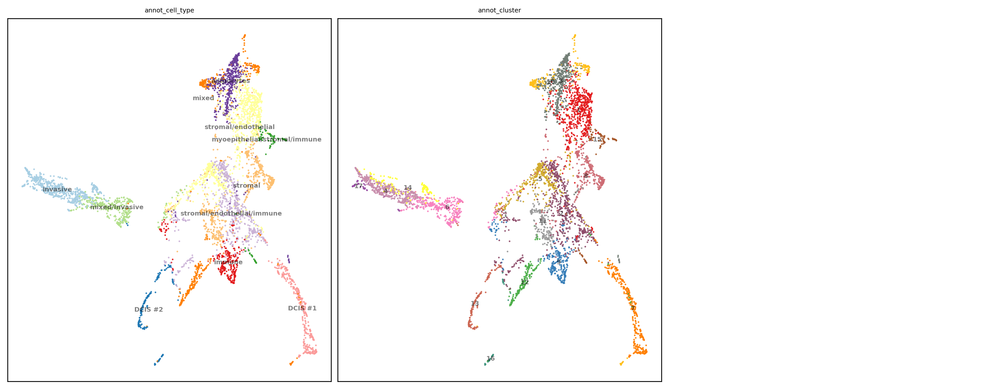

In [78]:
import concord as ccd
show_basis = f'X_umap'
show_cols = ['annot_cell_type', 'annot_cluster']
ccd.pl.plot_embedding(
    visium_adata, show_basis, show_cols, figsize=(13,5), dpi=300, ncols=3, font_size=6, point_size=10, legend_loc='on data',
    pal=pal,
    save_path=save_dir / f"embeddings_{show_basis}_{file_suffix}.png"
)

In [ ]:
import concord as ccd
cur_ccd = ccd.Concord(adata=visium_adata, 
                      latent_dim = n_latent,
                      save_dir=save_dir, # directory to save model checkpoints
                      inplace=False, # whether to modify adata in place
                      ) 

# Encode data, saving the latent embedding in adata.obsm['Concord']
output_key = 'Concord'
cur_ccd.encode_adata(input_layer_key='X', output_key=output_key, preprocess=False)
visium_adata.obsm = cur_ccd.adata.obsm.copy()
# Save the latent embedding to a file, so that it can be loaded later
ccd.ul.save_obsm_to_hdf5(cur_ccd.adata, save_dir / f"obsm_{file_suffix}.h5")

Concord - WARNING - No input feature list provided. It is recommended to first select features using the command `concord.ul.select_features()`.
Concord - WARNING - domain/batch information not found, all samples will be treated as from single domain/batch.


/opt/anaconda3/envs/concord/lib/python3.12/site-packages/anndata/_core/anndata.py:1758: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/opt/anaconda3/envs/concord/lib/python3.12/site-packages/sklearn/utils/sparsefuncs.py:736: RuntimeWarning: divide by zero encountered in matmul
  matvec=lambda x: X @ x - offset @ x,
/opt/anaconda3/envs/concord/lib/python3.12/site-packages/sklearn/utils/sparsefuncs.py:736: RuntimeWarning: overflow encountered in matmul
  matvec=lambda x: X @ x - offset @ x,
/opt/anaconda3/envs/concord/lib/python3.12/site-packages/sklearn/utils/sparsefuncs.py:736: RuntimeWarning: invalid value encountered in matmul
  matvec=lambda x: X @ x - offset @ x,
FAISS not found. Using sklearn for k-NN computation.
You specified p_intra_domain as 0.95 but you only have one domain. Resetting p_intra_domain to 1.0.


p_intra_knn: 0.3


Epoch 0 Training: 78it [00:01, 41.80it/s, loss=3.85]
Epoch 9 Training: 100%|██████████| 78/78 [00:01<00:00, 43.72it/s, loss=3.42]


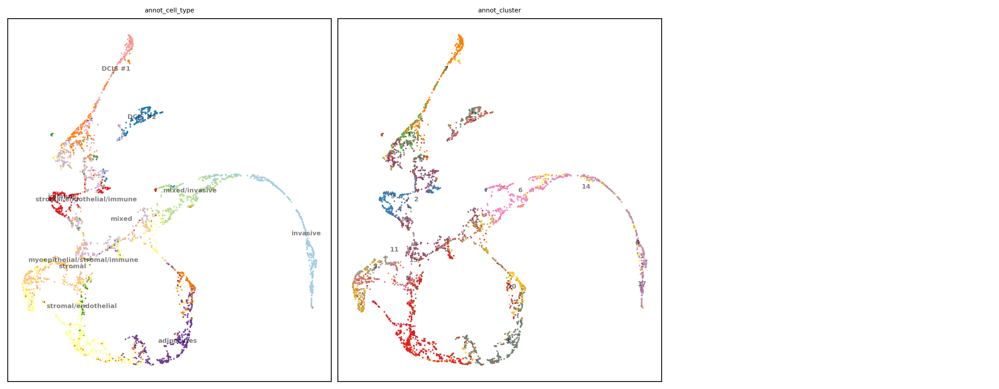

In [79]:
# compute umap
#ccd.ul.run_umap(visium_adata, source_key=output_key, result_key=f'{output_key}_UMAP', n_components=2, n_neighbors=15, min_dist=0.1, metric='euclidean')
show_basis = f'{output_key}_UMAP'
show_cols = ['annot_cell_type', 'annot_cluster']
ccd.pl.plot_embedding(
    visium_adata, show_basis, show_cols, figsize=(13,5), dpi=300, ncols=3, font_size=6, point_size=10, legend_loc='on data',
    pal=pal,
    save_path=save_dir / f"embeddings_{show_basis}_{file_suffix}.png"
)

In [73]:
visium_adata.obsm['Visium_array'] = visium_tissue_positions[['array_row', 'array_col']].values

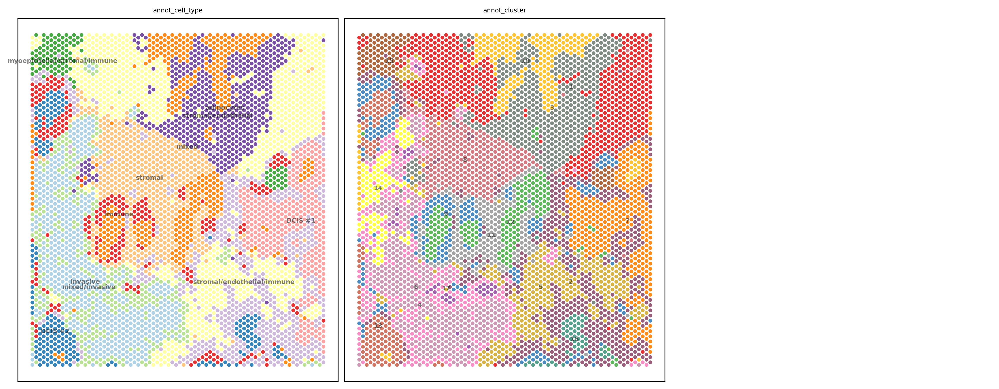

In [81]:
# compute umap
#ccd.ul.run_umap(visium_adata, source_key=output_key, result_key=f'{output_key}_UMAP', n_components=2, n_neighbors=15, min_dist=0.1, metric='euclidean')
show_basis = f'Visium_array'
show_cols = ['annot_cell_type', 'annot_cluster']
ccd.pl.plot_embedding(
    visium_adata, show_basis, show_cols, figsize=(13,5), dpi=300, ncols=3, font_size=6, point_size=50, legend_loc='on data',
    pal=pal,
    save_path=save_dir / f"embeddings_{show_basis}_{file_suffix}.png"
)

In [ ]:
visium_adata.write_h5ad(data_dir / f"visium_adata_{file_suffix}.h5ad")
print(f"Saved visium_adata to {data_dir / f'visium_adata_{file_suffix}.h5ad'}")

In [136]:
ccd.ul.anndata_to_viscello(visium_adata, data_dir / f"cello_visium_{proj_name}_{file_suffix}", project_name = proj_name, organism='hsa')

VisCello project created at ../data/janesick_nature_comms_2023/cello_visium_janesick_nc_2023_dev_Jun03-1817


### Xenium rep1 adata analysis

In [ ]:
import scanpy as sc

# Load data
xenium_rep1_adata = sc.read_10x_h5(xenium_rep1_path / "cell_feature_matrix.h5")
# concat xenium_cell_info, xenium_celltype_df to xenium_adata.obs
xenium_rep1_adata.obs = xenium_rep1_cell_info.join(xenium_rep1_celltype_df, how='left')
# Add the cell type as a categorical variable
xenium_rep1_adata.obs['annot_cell_type'] = xenium_rep1_adata.obs['Cluster'].astype('category')
xenium_rep1_adata.layers['counts'] = xenium_rep1_adata.X.copy()

In [50]:
# Normalize visium_adata
xenium_rep1_adata.layers['counts'] = xenium_rep1_adata.X.copy()
sc.pp.normalize_total(xenium_rep1_adata, target_sum=1e4)
# log transform
sc.pp.log1p(xenium_rep1_adata)
# PCA and UMAP
n_latent = 30
sc.pp.pca(xenium_rep1_adata, n_comps=n_latent, svd_solver='arpack')
sc.pp.neighbors(xenium_rep1_adata, n_neighbors=15, n_pcs=n_latent)
sc.tl.umap(xenium_rep1_adata, min_dist=0.1, n_components=2)

/opt/anaconda3/envs/concord/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:235: UserWarning: Some cells have zero counts
  warn(UserWarning("Some cells have zero counts"))
/opt/anaconda3/envs/concord/lib/python3.12/site-packages/sklearn/utils/sparsefuncs.py:737: RuntimeWarning: divide by zero encountered in matmul
  matmat=lambda x: X @ x - offset @ x,
/opt/anaconda3/envs/concord/lib/python3.12/site-packages/sklearn/utils/sparsefuncs.py:737: RuntimeWarning: overflow encountered in matmul
  matmat=lambda x: X @ x - offset @ x,
/opt/anaconda3/envs/concord/lib/python3.12/site-packages/sklearn/utils/sparsefuncs.py:737: RuntimeWarning: invalid value encountered in matmul
  matmat=lambda x: X @ x - offset @ x,
OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


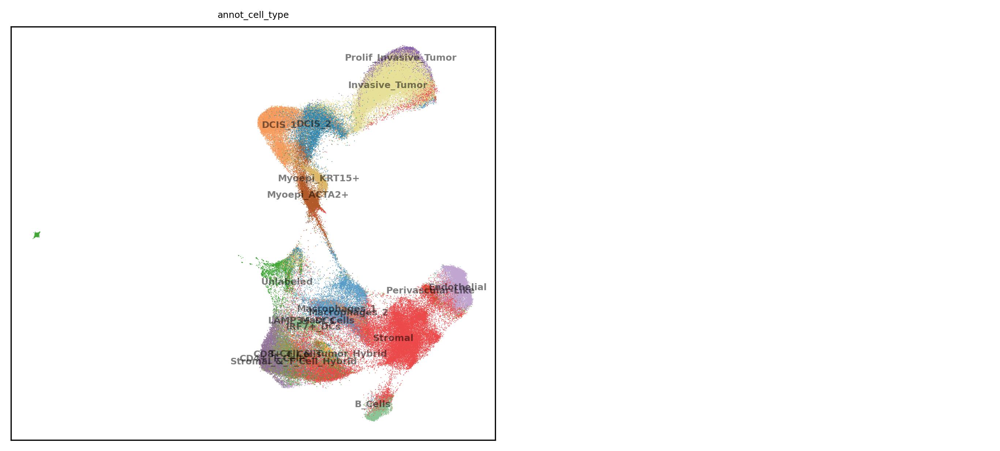

In [52]:
import concord as ccd
_, _, ct_pal = ccd.pl.get_color_mapping(xenium_rep1_adata, 'annot_cell_type', pal='Paired', seed=1)
pal = {'annot_cell_type':ct_pal}
show_basis = f'X_umap'
show_cols = ['annot_cell_type']
ccd.pl.plot_embedding(
    xenium_rep1_adata, show_basis, show_cols, figsize=(9,4), dpi=300, ncols=2,  font_size=6, point_size=1, legend_loc='on data',
    pal=pal,
    save_path=save_dir / f"xenium_rep1_embeddings_{show_basis}_{file_suffix}.png"
)

In [53]:
import concord as ccd
cur_ccd = ccd.Concord(adata=xenium_rep1_adata, 
                      latent_dim = n_latent,
                      save_dir=save_dir, # directory to save model checkpoints
                      inplace=False, # whether to modify adata in place
                      ) 

# Encode data, saving the latent embedding in adata.obsm['Concord']
output_key = 'Concord'
cur_ccd.encode_adata(input_layer_key='X', output_key=output_key, preprocess=False)
xenium_rep1_adata.obsm = cur_ccd.adata.obsm.copy()
# Save the latent embedding to a file, so that it can be loaded later
ccd.ul.save_obsm_to_hdf5(cur_ccd.adata, save_dir / f"xenium_rep1_obsm_{file_suffix}.h5")

Concord - WARNING - No input feature list provided. It is recommended to first select features using the command `concord.ul.select_features()`.
Concord - WARNING - domain/batch information not found, all samples will be treated as from single domain/batch.


FAISS not found. Using sklearn for k-NN computation.
You specified p_intra_domain as 0.95 but you only have one domain. Resetting p_intra_domain to 1.0.


p_intra_knn: 0.3


Epoch 0 Training: 2621it [00:10, 255.72it/s, loss=3.69]
Epoch 9 Training: 100%|██████████| 2621/2621 [00:09<00:00, 267.91it/s, loss=3.45]


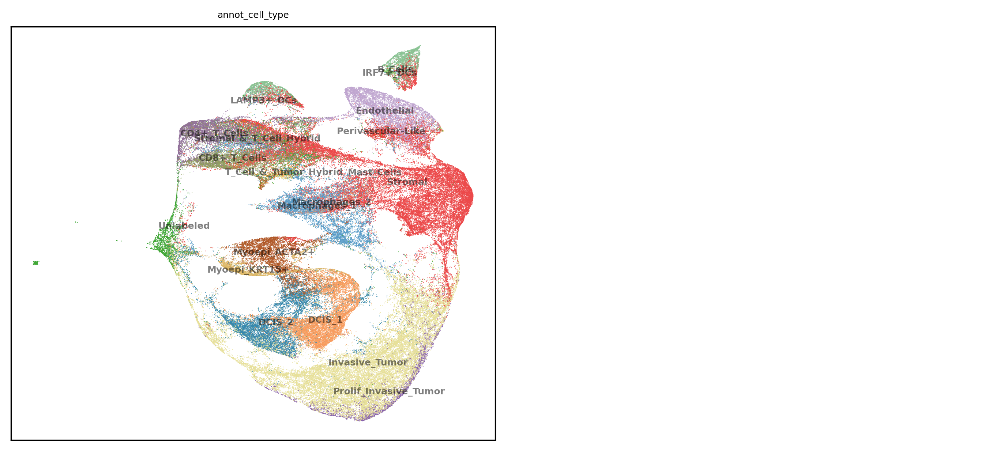

In [ ]:
# compute umap
ccd.ul.run_umap(xenium_rep1_adata, source_key=output_key, result_key=f'{output_key}_UMAP', n_components=2, n_neighbors=15, min_dist=0.1, metric='euclidean')
show_basis = f'{output_key}_UMAP'
show_cols = ['annot_cell_type']
ccd.pl.plot_embedding(
    xenium_rep1_adata, show_basis, show_cols, figsize=(9,4), dpi=300, ncols=2, font_size=6, point_size=1, legend_loc='on data',
    pal=pal,
    save_path=save_dir / f"xenium_rep1_embeddings_{show_basis}_{file_suffix}.png"
)

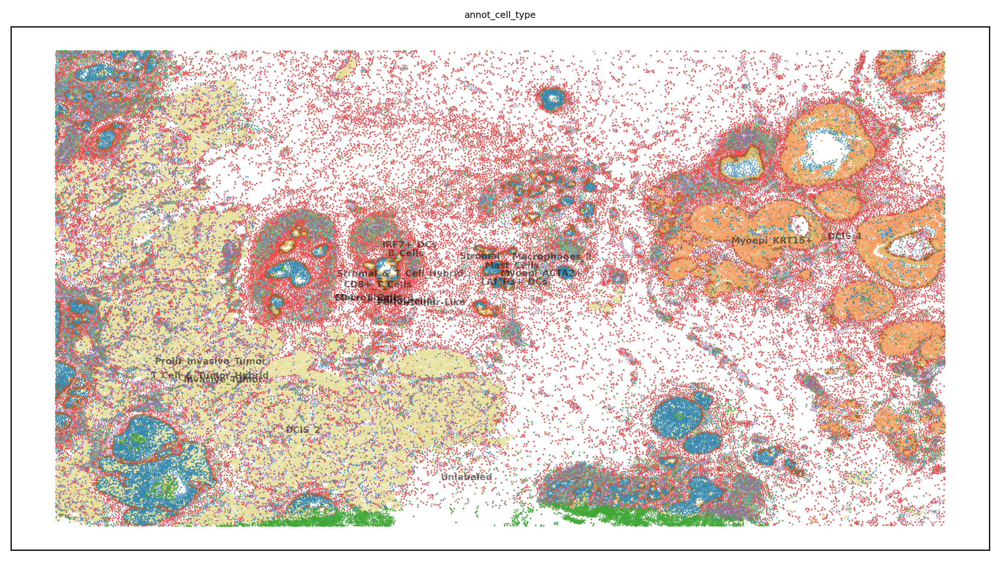

In [55]:
xenium_rep1_adata.obsm['Xenium_centroid'] = xenium_rep1_cell_info[['x_centroid', 'y_centroid']].values
show_basis = f'Xenium_centroid'
show_cols = ['annot_cell_type']
ccd.pl.plot_embedding(
    xenium_rep1_adata, show_basis, show_cols, figsize=(9,5), dpi=300, ncols=1, font_size=6, point_size=5, legend_loc='on data',
    pal=pal,
    save_path=save_dir / f"xenium_rep1_{show_basis}_{file_suffix}.png"
)

In [66]:
xenium_rep1_adata.obs_names

Index([     1,      2,      3,      4,      5,      6,      7,      8,      9,
           10,
       ...
       167771, 167772, 167773, 167774, 167775, 167776, 167777, 167778, 167779,
       167780],
      dtype='int64', name='cell_id', length=167780)

In [69]:
xenium_rep1_adata.obs['replicate'] = 'rep1'
xenium_rep1_adata.obs_names = "xenium_rep1_" + xenium_rep1_adata.obs_names.astype(str)
xenium_rep1_adata.write_h5ad(data_dir / f"xenium_rep1_adata_{file_suffix}.h5ad")
print(f"Saved xenium_rep1_adata to {data_dir / f'xenium_rep1_adata_{file_suffix}.h5ad'}")
ccd.ul.anndata_to_viscello(xenium_rep1_adata, data_dir / f"cello_xenium_rep1_{proj_name}_{file_suffix}", project_name = proj_name, organism='hsa')
print(f"Saved viscello to {data_dir / f'cello_xenium_rep1_{proj_name}_{file_suffix}.h5ad'}")


Saved xenium_rep1_adata to ../data/janesick_nature_comms_2023/xenium_rep1_adata_Jun05-1233.h5ad
VisCello project created at ../data/janesick_nature_comms_2023/cello_xenium_rep1_janesick_nc_2023_dev_Jun05-1233
Saved viscello to ../data/janesick_nature_comms_2023/cello_xenium_rep1_janesick_nc_2023_dev_Jun05-1233.h5ad


### Xenium rep2 adata analysis

In [57]:
import scanpy as sc

# Load data
xenium_rep2_adata = sc.read_10x_h5(xenium_rep2_path / "cell_feature_matrix.h5")
# concat xenium_cell_info, xenium_celltype_df to xenium_adata.obs
xenium_rep2_adata.obs = xenium_rep2_cell_info.join(xenium_rep2_celltype_df, how='left')
# Add the cell type as a categorical variable
xenium_rep2_adata.obs['annot_cell_type'] = xenium_rep2_adata.obs['Cluster'].astype('category')
xenium_rep2_adata.layers['counts'] = xenium_rep2_adata.X.copy()

In [58]:
# Normalize visium_adata
xenium_rep2_adata.layers['counts'] = xenium_rep2_adata.X.copy()
sc.pp.normalize_total(xenium_rep2_adata, target_sum=1e4)
# log transform
sc.pp.log1p(xenium_rep2_adata)
# PCA and UMAP
n_latent = 30
sc.pp.pca(xenium_rep2_adata, n_comps=n_latent, svd_solver='arpack')
sc.pp.neighbors(xenium_rep2_adata, n_neighbors=15, n_pcs=n_latent)
sc.tl.umap(xenium_rep2_adata, min_dist=0.1, n_components=2)

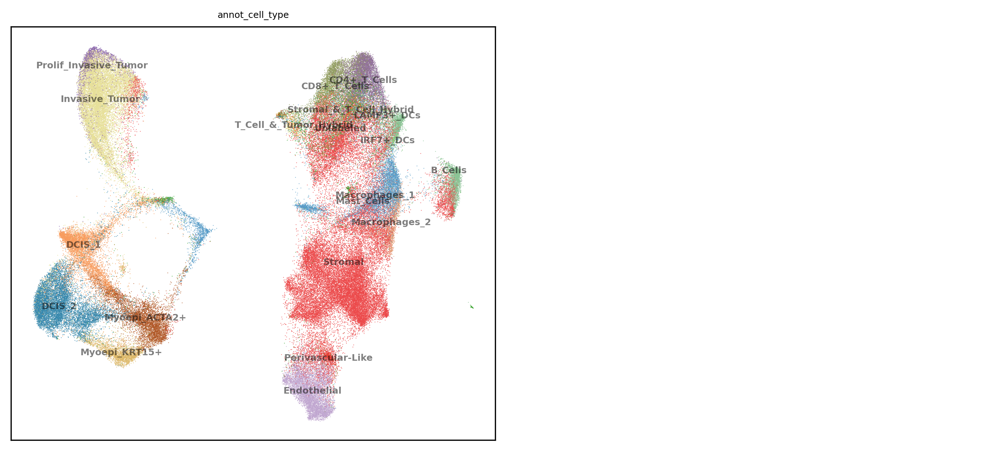

In [60]:
import concord as ccd
_, _, ct_pal = ccd.pl.get_color_mapping(xenium_rep2_adata, 'annot_cell_type', pal='Paired', seed=1)
pal = {'annot_cell_type':ct_pal}
show_basis = f'X_umap'
show_cols = ['annot_cell_type']
ccd.pl.plot_embedding(
    xenium_rep2_adata, show_basis, show_cols, figsize=(9,4), dpi=300, ncols=2,  font_size=6, point_size=1, legend_loc='on data',
    pal=pal,
    save_path=save_dir / f"xenium_rep2_embeddings_{show_basis}_{file_suffix}.png"
)

In [61]:
import concord as ccd
cur_ccd = ccd.Concord(adata=xenium_rep2_adata, 
                      latent_dim = n_latent,
                      save_dir=save_dir, # directory to save model checkpoints
                      inplace=False, # whether to modify adata in place
                      ) 

# Encode data, saving the latent embedding in adata.obsm['Concord']
output_key = 'Concord'
cur_ccd.encode_adata(input_layer_key='X', output_key=output_key, preprocess=False)
xenium_rep2_adata.obsm = cur_ccd.adata.obsm.copy()
# Save the latent embedding to a file, so that it can be loaded later
ccd.ul.save_obsm_to_hdf5(cur_ccd.adata, save_dir / f"xenium_rep2_obsm_{file_suffix}.h5")

Concord - WARNING - No input feature list provided. It is recommended to first select features using the command `concord.ul.select_features()`.
Concord - WARNING - domain/batch information not found, all samples will be treated as from single domain/batch.


FAISS not found. Using sklearn for k-NN computation.
You specified p_intra_domain as 0.95 but you only have one domain. Resetting p_intra_domain to 1.0.


p_intra_knn: 0.3


Epoch 0 Training: 1855it [00:05, 344.71it/s, loss=3.71]
Epoch 9 Training: 100%|██████████| 1855/1855 [00:05<00:00, 326.20it/s, loss=3.57]


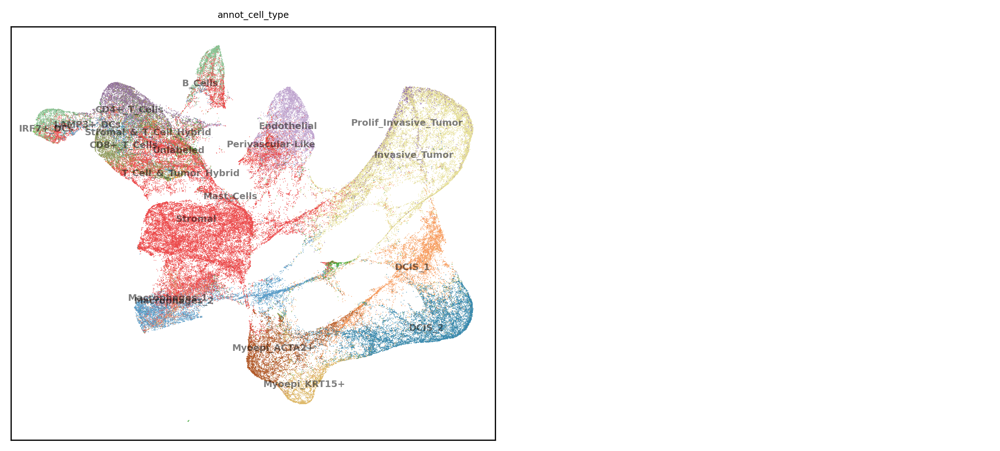

In [62]:
# compute umap
ccd.ul.run_umap(xenium_rep2_adata, source_key=output_key, result_key=f'{output_key}_UMAP', n_components=2, n_neighbors=15, min_dist=0.1, metric='euclidean')
show_basis = f'{output_key}_UMAP'
show_cols = ['annot_cell_type']
ccd.pl.plot_embedding(
    xenium_rep2_adata, show_basis, show_cols, figsize=(9,4), dpi=300, ncols=2, font_size=6, point_size=1, legend_loc='on data',
    pal=pal,
    save_path=save_dir / f"xenium_rep2_embeddings_{show_basis}_{file_suffix}.png"
)

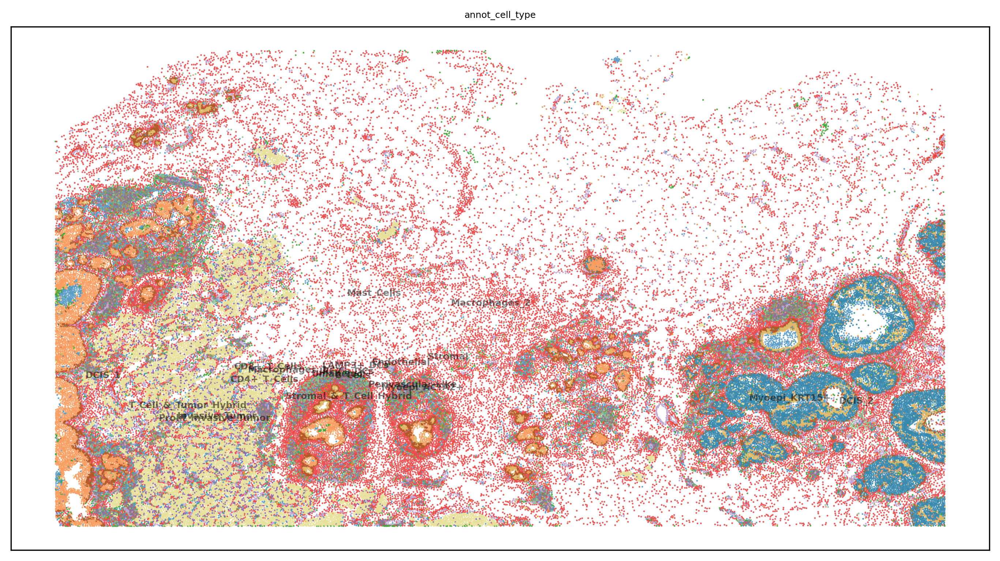

In [63]:
xenium_rep2_adata.obsm['Xenium_centroid'] = xenium_rep2_cell_info[['x_centroid', 'y_centroid']].values
show_basis = f'Xenium_centroid'
show_cols = ['annot_cell_type']
ccd.pl.plot_embedding(
    xenium_rep2_adata, show_basis, show_cols, figsize=(9,5), dpi=300, ncols=1, font_size=6, point_size=5, legend_loc='on data',
    pal=pal,
    save_path=save_dir / f"xenium_rep2_{show_basis}_{file_suffix}.png"
)

In [70]:
xenium_rep2_adata.obs['replicate'] = 'rep2'
xenium_rep2_adata.obs_names = "xenium_rep2_" + xenium_rep2_adata.obs_names.astype(str)
xenium_rep2_adata.write_h5ad(data_dir / f"xenium_rep2_adata_{file_suffix}.h5ad")
print(f"Saved xenium_rep2_adata to {data_dir / f'xenium_rep2_adata_{file_suffix}.h5ad'}")
ccd.ul.anndata_to_viscello(xenium_rep2_adata, data_dir / f"cello_xenium_rep2_{proj_name}_{file_suffix}", project_name = proj_name, organism='hsa')
print(f"Saved viscello to {data_dir / f'cello_xenium_rep2_{proj_name}_{file_suffix}.h5ad'}")


Saved xenium_rep2_adata to ../data/janesick_nature_comms_2023/xenium_rep2_adata_Jun05-1233.h5ad
VisCello project created at ../data/janesick_nature_comms_2023/cello_xenium_rep2_janesick_nc_2023_dev_Jun05-1233
Saved viscello to ../data/janesick_nature_comms_2023/cello_xenium_rep2_janesick_nc_2023_dev_Jun05-1233.h5ad


### Combine Xenium data

In [71]:
# Combine Xenium rep1 and rep2 data
xenium_adata = xenium_rep1_adata.concatenate(
    xenium_rep2_adata, batch_key="replicate", batch_categories=["rep1", "rep2"]
)

In [ ]:
# Normalize visium_adata
xenium_adata.X = xenium_adata.layers['counts'].copy()
sc.pp.normalize_total(xenium_adata, target_sum=1e4)
# log transform
sc.pp.log1p(xenium_adata)
# PCA and UMAP
n_latent = 30
sc.pp.pca(xenium_adata, n_comps=n_latent, svd_solver='arpack')
sc.pp.neighbors(xenium_adata, n_neighbors=15, n_pcs=n_latent)
sc.tl.umap(xenium_adata, min_dist=0.1, n_components=2)

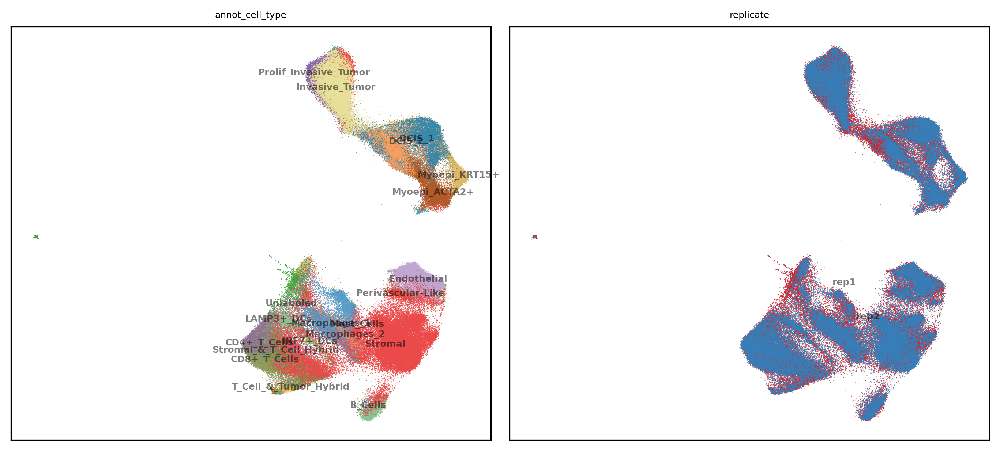

In [156]:
import concord as ccd
_, _, ct_pal = ccd.pl.get_color_mapping(xenium_adata, 'annot_cell_type', pal='Paired', seed=1)
_, _, batch_pal = ccd.pl.get_color_mapping(xenium_adata, 'replicate', pal='Set1', seed=1)
pal = {'annot_cell_type':ct_pal, 'replicate':batch_pal}
show_basis = f'X_umap'
show_cols = ['annot_cell_type', 'replicate']
ccd.pl.plot_embedding(
    xenium_adata, show_basis, show_cols, figsize=(9,4), dpi=300, ncols=2,  font_size=6, point_size=1, legend_loc='on data',
    pal=pal,
    save_path=save_dir / f"xenium_embeddings_{show_basis}_{file_suffix}.png"
)

In [ ]:
import concord as ccd
cur_ccd = ccd.Concord(adata=xenium_adata, 
                      latent_dim = n_latent,
                      domain_key='replicate', # domain key to use for domain adaptation
                      save_dir=save_dir, # directory to save model checkpoints
                      inplace=False, # whether to modify adata in place
                      ) 

# Encode data, saving the latent embedding in adata.obsm['Concord']
output_key = 'Concord'
cur_ccd.encode_adata(input_layer_key='X', output_key=output_key, preprocess=False)
xenium_adata.obsm = cur_ccd.adata.obsm.copy()
# Save the latent embedding to a file, so that it can be loaded later
ccd.ul.save_obsm_to_hdf5(cur_ccd.adata, save_dir / f"xenium_obsm_{file_suffix}.h5")

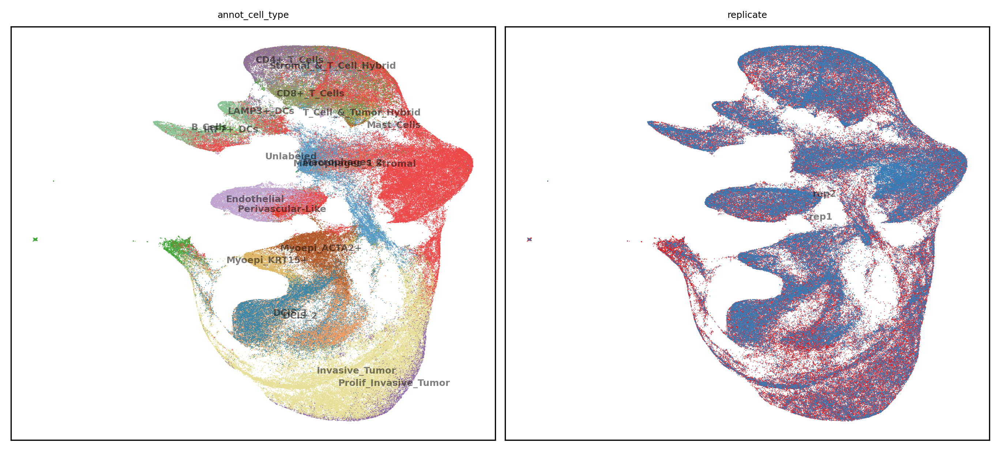

In [91]:
# compute umap
#ccd.ul.run_umap(xenium_adata, source_key=output_key, result_key=f'{output_key}_UMAP', n_components=2, n_neighbors=15, min_dist=0.1, metric='euclidean')
show_basis = f'{output_key}_UMAP'
show_cols = ['annot_cell_type', 'replicate']
ccd.pl.plot_embedding(
    xenium_adata, show_basis, show_cols, figsize=(9,4), dpi=300, ncols=2, font_size=6, point_size=1, legend_loc='on data',
    pal=pal,
    save_path=save_dir / f"xenium_embeddings_{show_basis}_{file_suffix}.png"
)

In [142]:

xenium_adata.write_h5ad(data_dir / f"xenium_adata_{file_suffix}.h5ad")
print(f"Saved xenium_adata to {data_dir / f'xenium_adata_{file_suffix}.h5ad'}")
ccd.ul.anndata_to_viscello(xenium_adata, data_dir / f"cello_xenium_{proj_name}_{file_suffix}", project_name = proj_name, organism='hsa')


Saved xenium_adata to ../data/janesick_nature_comms_2023/xenium_adata_Jun05-1233.h5ad
VisCello project created at ../data/janesick_nature_comms_2023/cello_xenium_janesick_nc_2023_dev_Jun05-1233


In [143]:
xenium_rep1_adata.obs_names

Index(['xenium_rep1_1', 'xenium_rep1_2', 'xenium_rep1_3', 'xenium_rep1_4',
       'xenium_rep1_5', 'xenium_rep1_6', 'xenium_rep1_7', 'xenium_rep1_8',
       'xenium_rep1_9', 'xenium_rep1_10',
       ...
       'xenium_rep1_167771', 'xenium_rep1_167772', 'xenium_rep1_167773',
       'xenium_rep1_167774', 'xenium_rep1_167775', 'xenium_rep1_167776',
       'xenium_rep1_167777', 'xenium_rep1_167778', 'xenium_rep1_167779',
       'xenium_rep1_167780'],
      dtype='object', name='cell_id', length=167780)

In [147]:
# check overlap between xenium_adata and xenium_rep1_adata
np.sum(xenium_rep1_adata.obs_names.isin(xenium_adata.obs_names))

np.int64(0)

In [151]:
xenium_adata.obs_names

Index(['xenium_rep1_1-rep1', 'xenium_rep1_2-rep1', 'xenium_rep1_3-rep1',
       'xenium_rep1_4-rep1', 'xenium_rep1_5-rep1', 'xenium_rep1_6-rep1',
       'xenium_rep1_7-rep1', 'xenium_rep1_8-rep1', 'xenium_rep1_9-rep1',
       'xenium_rep1_10-rep1',
       ...
       'xenium_rep2_118743-rep2', 'xenium_rep2_118744-rep2',
       'xenium_rep2_118745-rep2', 'xenium_rep2_118746-rep2',
       'xenium_rep2_118747-rep2', 'xenium_rep2_118748-rep2',
       'xenium_rep2_118749-rep2', 'xenium_rep2_118750-rep2',
       'xenium_rep2_118751-rep2', 'xenium_rep2_118752-rep2'],
      dtype='object', name='cell_id', length=286532)

In [150]:
xenium_rep1_adata.obs_names

Index(['xenium_rep1_1', 'xenium_rep1_2', 'xenium_rep1_3', 'xenium_rep1_4',
       'xenium_rep1_5', 'xenium_rep1_6', 'xenium_rep1_7', 'xenium_rep1_8',
       'xenium_rep1_9', 'xenium_rep1_10',
       ...
       'xenium_rep1_167771', 'xenium_rep1_167772', 'xenium_rep1_167773',
       'xenium_rep1_167774', 'xenium_rep1_167775', 'xenium_rep1_167776',
       'xenium_rep1_167777', 'xenium_rep1_167778', 'xenium_rep1_167779',
       'xenium_rep1_167780'],
      dtype='object', name='cell_id', length=167780)

In [152]:
# Append "_sub" to names of xenium_rep1_adata.obsm and xenium_rep2_adata.obsm
#xenium_rep1_adata.obsm = {k + "_sub": v for k, v in xenium_rep1_adata.obsm.items()}
#xenium_rep2_adata.obsm = {k + "_sub": v for k, v in xenium_rep2_adata.obsm.items()}
xenium_rep1_adata.obs_names = xenium_rep1_adata.obs_names + '-rep1'
xenium_rep2_adata.obs_names = xenium_rep2_adata.obs_names + '-rep2'
adata_subsets = {
    "xenium_rep1": xenium_rep1_adata,
    "xenium_rep2": xenium_rep2_adata,
}

viscello_dir = str(data_dir / f"cello_xenium_janesick_nc_2023_dev_Jun05-1233")
ccd.ul.update_clist_with_subsets(global_adata = xenium_adata, adata_subsets = adata_subsets, viscello_dir = viscello_dir)

Loading existing clist from: ../data/janesick_nature_comms_2023/cello_xenium_janesick_nc_2023_dev_Jun05-1233
Processing subset: xenium_rep1
Processing subset: xenium_rep2
Updated clist saved to: ../data/janesick_nature_comms_2023/cello_xenium_janesick_nc_2023_dev_Jun05-1233/clist.rds
